In [223]:
import os
import pickle
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np
import seaborn as sns

# Load data

In [ ]:
filename = "/home/clevyfidel/Documents/Workspace/goin/opt_coin/output/inference_results_512_moreconfigs_parallel.pkl"

with open(filename, 'rb') as f:
    data = pickle.load(f)

In [ ]:
data

{0: {'gamma_t': np.float64(0.1),
  'alpha_t': np.float64(0.1),
  'rho_t': np.float64(0.1),
  'ctx_count': 4,
  'Python': {'time': 278.20295736789706,
   'logp_y_avg': array([ 0.76258377,  0.72489794,  0.77297701,  0.753083  ,  0.68429829,
           0.73397607,  0.76619039,  0.7931606 ,  0.79700838,  0.82225349,
           0.73271888,  0.78274245,  0.82935984,  0.75798819,  0.75511049,
           0.81011029,  0.83146966,  0.77428333,  0.78810158,  0.81151926,
           0.78912962,  0.82842165,  0.80223197,  0.77384513,  0.74741869,
           0.82113627,  0.81765769,  0.75457451,  0.82467966,  0.79991067,
           0.75117768,  0.75480068,  0.7104013 ,  0.72437554,  0.6798644 ,
           0.70756623,  0.82666833,  0.78717016,  0.74784644,  0.77933781,
           0.76737221,  0.76611249,  0.77395303,  0.83812394,  0.77622482,
           0.80848668,  0.77845475,  0.83273229,  0.80082569,  0.8041811 ,
           0.68739221,  0.80950489,  0.80153883,  0.75877725,  0.80151786,
           

In [5]:
len(data.keys())

294

In [6]:
data[0].keys()

dict_keys(['gamma_t', 'alpha_t', 'rho_t', 'ctx_count', 'Python', 'Leaky'])

In [7]:
data[0]['Python'].keys()

dict_keys(['time', 'logp_y_avg', 'logp_y_sum', 'mse_y_avg', 'logp_c_avg', 'logp_c_sum'])

## Create datasets

In [8]:
df_logpy = []
df_logpc = [] 
df_time = [] 
df_mse = [] 

for id_config in data.keys():
    df_logpy_partial = pd.DataFrame.from_dict({'python': data[id_config]['Python']['logp_y_avg'],
                               'leaky': data[id_config]['Leaky']['logp_y_avg']})
    df_logpy_partial['config'] = id_config
    df_logpy.append(df_logpy_partial)

    
    df_logpc_partial = pd.DataFrame.from_dict({'python': data[id_config]['Python']['logp_c_avg'],
                               'leaky': data[id_config]['Leaky']['logp_c_avg']})
    df_logpc_partial['config'] = id_config
    df_logpc.append(df_logpc_partial)

    df_mse_partial = pd.DataFrame.from_dict({'python': data[id_config]['Python']['mse_y_avg'],
                               'leaky': data[id_config]['Leaky']['mse_y_avg']})
    df_mse_partial['config'] = id_config
    df_mse.append(df_mse_partial)


    df_time_partial = {'python': data[id_config]['Python']['time'],
                       'leaky': data[id_config]['Leaky']['time'],
                       'config': id_config}
    df_time.append(df_time_partial)

df_logpy = pd.concat(df_logpy, ignore_index=True)
df_logpc = pd.concat(df_logpc, ignore_index=True)
df_mse = pd.concat(df_mse, ignore_index=True)
df_time = pd.DataFrame(df_time)

In [9]:
df_logpy.describe()

,python,leaky,config
count,150528.000000,1.505280e+05,150528.000000
mean,0.423638,-4.394933e+04,146.500000
std,0.731472,6.861956e+06,84.870281
min,-36.043653,-1.625300e+09,0.000000
25%,0.323856,-1.909971e+01,73.000000
50%,0.707923,-2.304874e+00,146.500000
75%,0.766304,-7.575914e-02,220.000000
max,0.902780,7.323751e-01,293.000000


In [10]:
df_logpc.describe()

,python,leaky,config
count,150528.000000,150528.000000,150528.000000
mean,-1.308288,-1.095753,146.500000
std,1.929687,1.007516,84.870281
min,-10.822316,-8.918554,0.000000
25%,-2.303061,-1.833975,73.000000
50%,-0.179609,-0.782601,146.500000
75%,-0.003264,-0.175839,220.000000
max,-0.000065,-0.023251,293.000000


## Melt datasets for visualisations

In [11]:
# Melt the 3 models columns in one categorical one
df_logpy_ = df_logpy.melt(id_vars='config', value_vars=['python', 'leaky'], var_name='model', value_name='logpy')
df_logpc_ = df_logpc.melt(id_vars='config', value_vars=['python', 'leaky'], var_name='model', value_name='logpc')
df_mse_ = df_mse.melt(id_vars='config', value_vars=['python', 'leaky'], var_name='model', value_name='mse')
df_time_ = df_time.melt(id_vars='config', value_vars=['python', 'leaky'], var_name='model', value_name='time')

## Params config and N ctxs

In [12]:
df_params = [] 
for id_config in data.keys(): # 'gamma_t', 'alpha_t', 'rho_t'
    
    df_params_partial = {'gamma_t': data[id_config]['gamma_t'], # gamma_context
                       'alpha_t': data[id_config]['alpha_t'], # alpha_context
                       'rho_t': data[id_config]['rho_t'], # rho_context
                       'n_ctx': data[id_config]['ctx_count'], # '# contexts'
                       'config': id_config}
    df_params.append(df_params_partial)

pd.set_option('display.max_columns', None)
df_params = pd.DataFrame(df_params)
df_params['config'] = df_params['config'].astype(int)
df_params.set_index('config').transpose() # .apply(lambda x: f"{data[id_config]['ctx_count']:.0f}")

config,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293
gamma_t,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.1,0.2,0.5,1.0,2.0,5.0,10.0,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00,0.10,0.20,0.50,1.00,2.00,5.00,10.00
alpha_t,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.5,0.5,0.5,0.5,0.5,0.5,0.5,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,10.0,10.0,10.0,10.0,10.0,10.0,10.0,0.10,0.10,0.10,0.10,0.10,0.10,0.10,0.20,0.20,0.20,0.20,0.20,0.20,0.20,0.50,0.50,0.50,0.50,0.50,0.50,0.50,1.00,1.00,1.00,1.00,1.00,1.00,1.00,2.00,2.00,2.00,2.00,2.00,2.00,2.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,10.00,10.00,10.00,10.00,10.00,10.00,10.00,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.5,0.5,0.5,0.5,0.5,0.5,0.5,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,10.0,10.0,10.0,10.0,10.0,10.0,10.0,0.10,0.10,0.10,0.10,0.10,0.10,0.10,0.20,0.20,0.20,0.20,0.20,0.20,0.20,0.50,0.50,0.50,0.50,0.50,0.50,0.50,1.00,1.00,1.00,1.00,1.00,1.00,1.00,2.00,2.00,2.00,2.00,2.00,2.00,2.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,10.00,10.00,10.00,10.00,10.00,10.00,10.00,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.5,0.5,0.5,0.5,0.5,0.5,0.5,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,10.0,10.0,10.0,10.0,10.0,10.0,10.0,0.10,0.10,0.10,0.10,0.10,0.10,0.10,0.20,0.20,0.20,0.20,0.20,0.20,0.20,0.50,0.50,0.50,0.50,0.50,0.50,0.50,1.00,1.00,1.00,1.00,1.00,1.00,1.00,2.00,2.00,2.00,2.00,2.00,2.00,2.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,10.00,10.00,10.00,10.00,10.00,10.00,10.00
rho_t,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1

In [13]:
df_params['gamma_t'].unique(), df_params['alpha_t'].unique(), df_params['rho_t'].unique()

(array([ 0.1,  0.2,  0.5,  1. ,  2. ,  5. , 10. ]),
 array([ 0.1,  0.2,  0.5,  1. ,  2. ,  5. , 10. ]),
 array([0.1 , 0.25, 0.5 , 0.75, 0.9 , 0.99]))

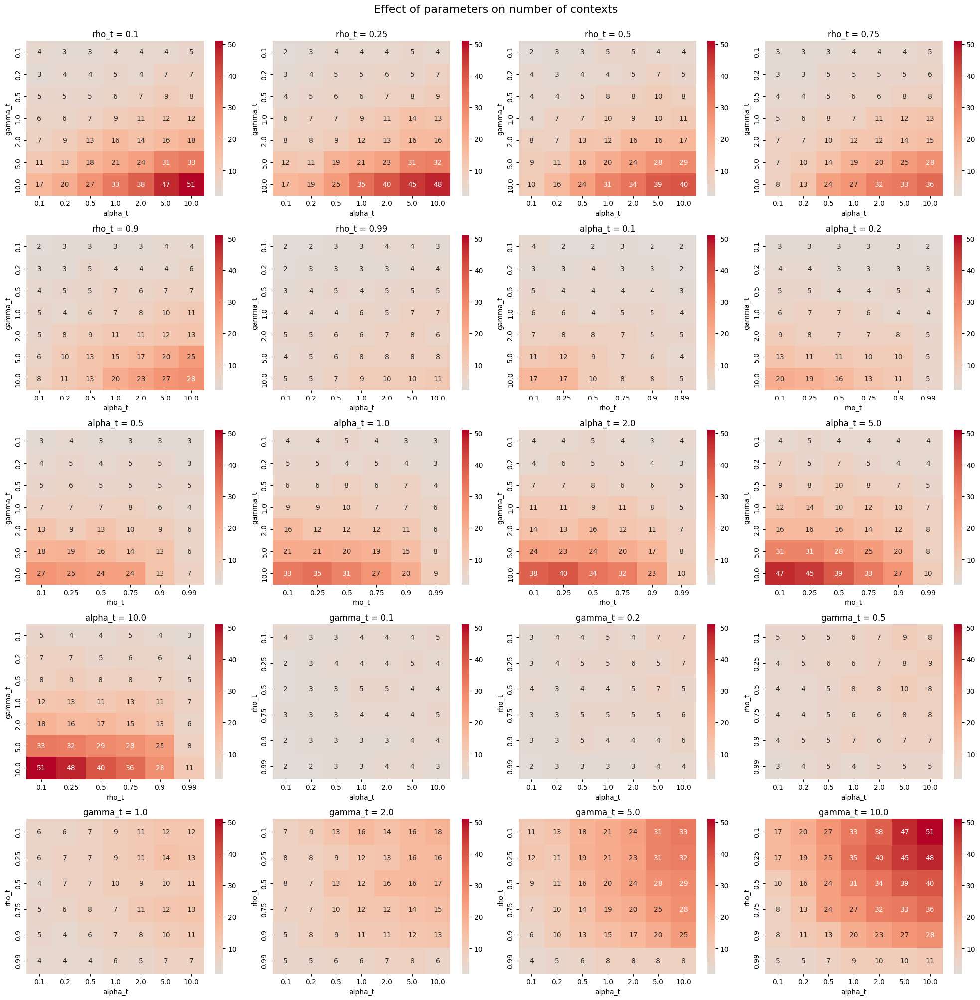

In [238]:
vmin = df_params['n_ctx'].min()
vmax = df_params['n_ctx'].max()

# List of (fixed_param, x_param, y_param, unique_values)
combinations = [
    ('rho_t', 'alpha_t', 'gamma_t', df_params['rho_t'].unique()),
    ('alpha_t', 'rho_t', 'gamma_t', df_params['alpha_t'].unique()),
    ('gamma_t', 'alpha_t', 'rho_t', df_params['gamma_t'].unique())
]

# Count total number of subplots needed
total_plots = sum(len(values) for _, _, _, values in combinations)

# Create subplots dynamically
ncols = 4 
nrows = int(np.ceil(total_plots / ncols))
fig, axs = plt.subplots(nrows, ncols, figsize=(5 * ncols, 4 * nrows))
axs = axs.flatten()

plot_idx = 0

for fixed_param, x_param, y_param, fixed_values in combinations:
    for val in fixed_values:
        subset = df_params[df_params[fixed_param] == val]
        pivot = subset.pivot_table(index=y_param, columns=x_param, values='n_ctx')

        sns.heatmap(pivot, annot=True, cmap='coolwarm', ax=axs[plot_idx],
                    vmin=vmin, vmax=vmax, center=0)

        axs[plot_idx].set_title(f"{fixed_param} = {val}")
        axs[plot_idx].set_xlabel(x_param)
        axs[plot_idx].set_ylabel(y_param)
        plot_idx += 1

# Hide unused axes if any
for ax in axs[plot_idx:]:
    ax.set_visible(False)

fig.suptitle("Effect of parameters on number of contexts", fontsize=16,y=1.0005)

plt.tight_layout()
plt.show()

# COIN vs LEAKY (relative)

Function for visualisations and inverting levels of parameters more easily

In [ ]:
def plot_rdif(df, level1, level2, level3, which):
    # Reorder the dataframe based on the given levels
    df_reordered = df.sort_values([level1, level2, level3]).reset_index(drop=True)
    df_reordered['config'] = df['config'].values

    # Compute summary statistics
    summary = df_reordered.groupby('config')['rdif'].agg(
        rdif_5=lambda x: np.percentile(x, 5),
        rdif_25=lambda x: np.percentile(x, 25),
        rdif_50='median',
        rdif_75=lambda x: np.percentile(x, 75),
        rdif_95=lambda x: np.percentile(x, 95)
    )
    summary['lower_err'] = summary['rdif_50'] - summary['rdif_25']
    summary['upper_err'] = summary['rdif_75'] - summary['rdif_50']

    # Determine number of unique values per parameter
    n1 = df[level1].nunique()
    n2 = df[level2].nunique()
    n3 = df[level3].nunique()

    # Colors 
    dict_colormaps = { 'rho_t': 'YlOrRd', 'alpha_t': 'Greens', 'gamma_t': 'Blues' }
    dict_colors = { 'rho_t': 'tab:orange', 'alpha_t': 'tab:green', 'gamma_t': 'tab:blue'}

    # Color map for level1 (slowest varying --> changing from color span to color span)
    cmap = plt.colormaps[dict_colormaps.get(level1)].resampled(n1)
    colors = cmap(np.arange(cmap.N))

    # Plot rdif median with IQR errorbar (= homemade boxplot)
    plt.figure(figsize=(24, 6))
    plt.errorbar(
        summary.index, summary['rdif_50'],
        yerr=[summary['lower_err'], summary['upper_err']],
        fmt='o', ecolor=dict_colors.get(level3), capsize=2, color='black', label='Median ± IQR'
    )
    plt.axhline(0, color='red', linestyle='--', linewidth=1)

    # Add color spans for level1
    xticks = []
    xticklabels = []
    for i in range(n1):
        start = i * n2 * n3
        end = start + n2 * n3
        plt.axvspan(start, end, facecolor=colors[i], alpha=0.25)
        xticks.append((start + end) / 2)
        xticklabels.append(f'{level1} = {df[level1].unique()[i]}')
    plt.gca().set_xticks(xticks, labels=xticklabels)
    plt.tick_params(axis="x", bottom=False, pad=20)

    # Add vertical lines separting intervals and secondary x-axis for level2  
    sec_xticks = []
    sec_xticklabels = []
    for i in range(n1 * n2):
        pos = i * n3
        plt.axvline(pos, color=dict_colors.get(level2), linestyle='dotted')
        sec_xticks.append(pos + (n3 / 2))
        sec_xticklabels.append(f'{df[level2].unique()[i % n2]}')  # cycle over level2
    sec = plt.gca().secondary_xaxis(location=0)
    sec.set_xticks(sec_xticks, labels=sec_xticklabels)
    sec.set_xlabel(f'{level2}=', loc='left', labelpad=-9)

    plt.yscale('symlog', linthresh=1)
    plt.ylabel('rdif')
    plt.title(f'Relative difference in log probabilities of {which}\n'
              f'(Fixed {level1} and {level2}, increasing {level3} per interval)')
    plt.legend()
    plt.tight_layout()
    plt.show()

## Logpy

### Relative difference (with adjusted logscale)

In [178]:
# Logp y (observations)
df_logpy_r = []

for id_config in data.keys():
    df_logpy_r_partial = pd.DataFrame.from_dict({'python': data[id_config]['Python']['logp_y_avg'],
                               'leaky': data[id_config]['Leaky']['logp_y_avg']})
    df_logpy_r_partial['config'] = id_config
    df_logpy_r_partial['alpha_t'] = data[id_config]['alpha_t']
    df_logpy_r_partial['gamma_t'] = data[id_config]['gamma_t']
    df_logpy_r_partial['rho_t'] = data[id_config]['rho_t']
    df_logpy_r_partial['n_ctx'] = data[id_config]['ctx_count']

 
    df_logpy_r.append(df_logpy_r_partial)
df_logpy_r = pd.concat(df_logpy_r, ignore_index=True)
df_logpy_r['rdif'] = (df_logpy_r['python'] - df_logpy_r['leaky']) # /df_logpy_r['leaky'] # relative point by point difference

df_logpy_r.columns

Index(['python', 'leaky', 'config', 'alpha_t', 'gamma_t', 'rho_t', 'n_ctx',
       'rdif'],
      dtype='object')

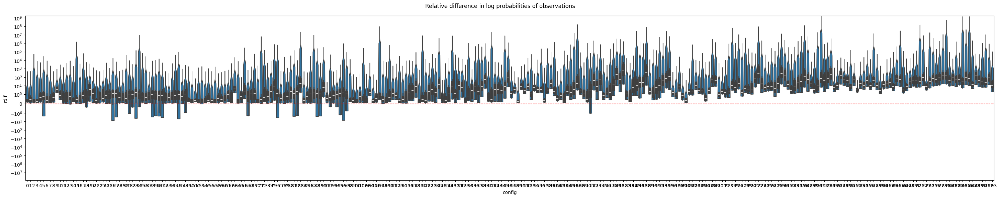

In [ ]:
# NOTE: Violintplots kept from previous comparison of 27 configs
fig, axs = plt.subplots(1,1,figsize=(30, 6))
sns.violinplot(data=df_logpy_r, y='rdif', x='config', ax=axs, dodge='auto', cut=0, density_norm="count")
axs.set_yscale('symlog', linthresh=1)
axs.axhline(0, color='red', linestyle='--', linewidth=1)
fig.suptitle('Relative difference in log probabilities of observations')
plt.tight_layout()

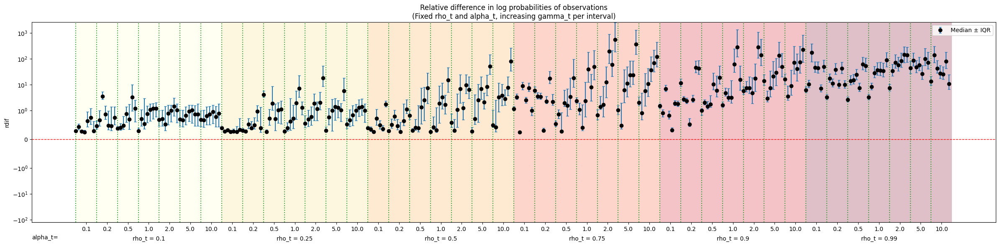

In [204]:
plot_rdif(df_logpy_r, 'rho_t','alpha_t','gamma_t', 'observations')

NOTE -- TODO: perform the same interverting of parameters level as below for contexts

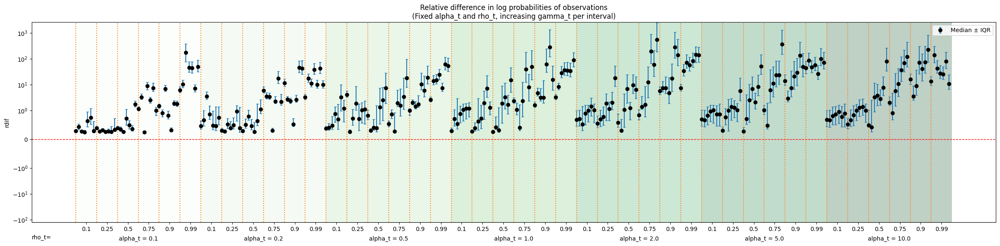

In [205]:
plot_rdif(df_logpy_r, 'alpha_t', 'rho_t', 'gamma_t', 'observations')

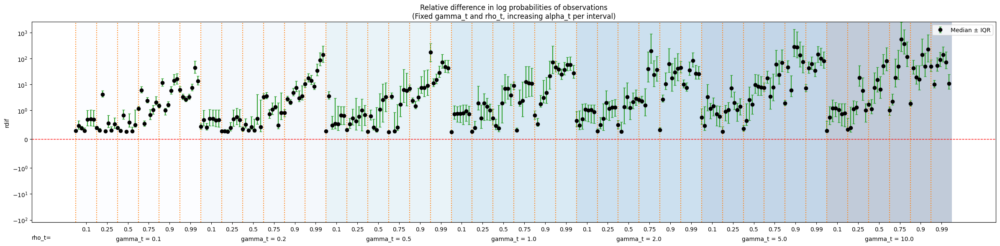

In [208]:
plot_rdif(df_logpy_r, 'gamma_t',  'rho_t', 'alpha_t', 'observations')

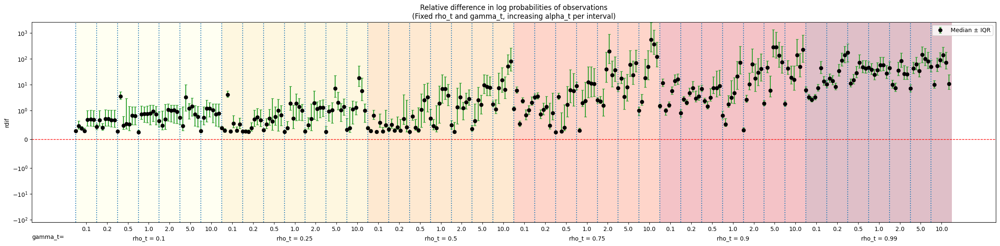

In [ ]:
plot_rdif(df_logpy_r, 'rho_t', 'gamma_t', 'alpha_t', 'observations')

### Parameter heatmaps

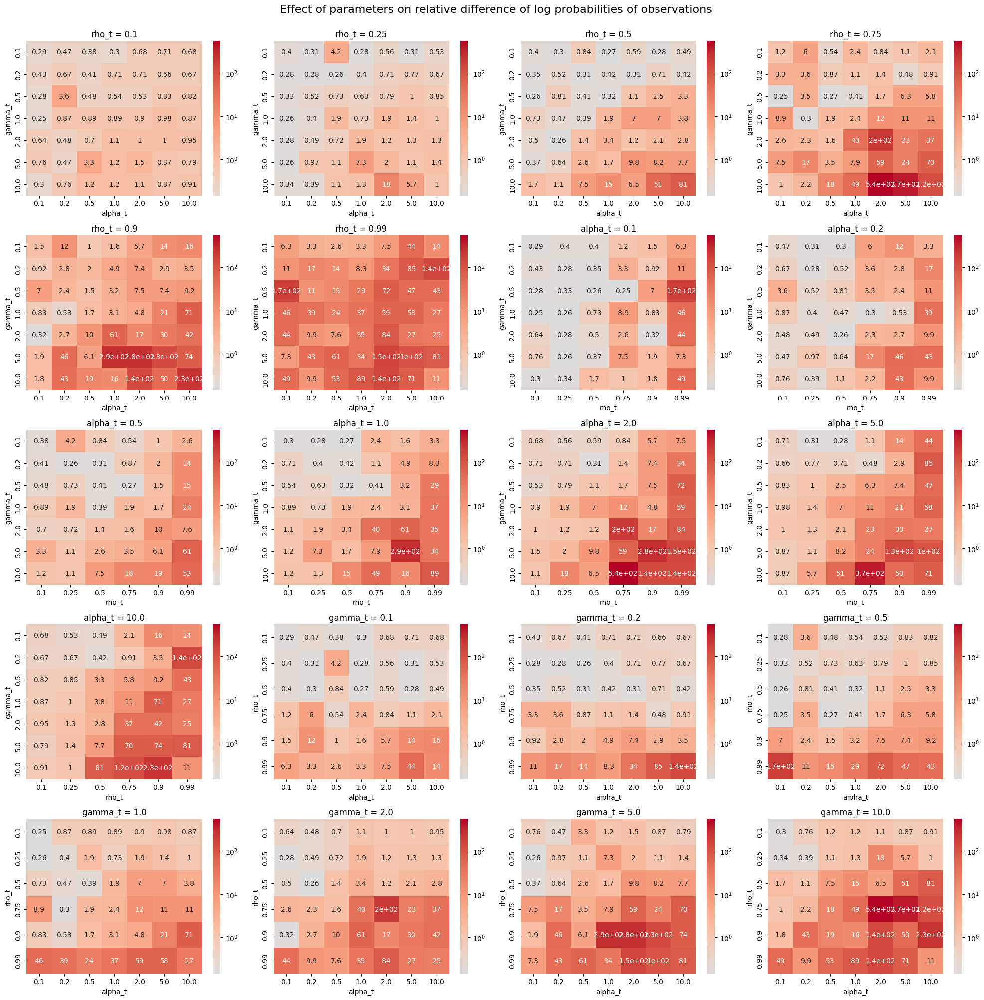

In [239]:
# Compute global vmin/vmax for consistent coloring across plots
vmin = df_logpy_r.groupby(['alpha_t', 'gamma_t', 'rho_t'])['rdif'].median().min()
vmax = df_logpy_r.groupby(['alpha_t', 'gamma_t', 'rho_t'])['rdif'].median().max()

norm = matplotlib.colors.SymLogNorm(linthresh=1, linscale=1, vmin=vmin, vmax=vmax)

# Define which parameters to fix and which to plot
combinations = [
    ('rho_t', 'alpha_t', 'gamma_t', df_logpy_r['rho_t'].unique()),
    ('alpha_t', 'rho_t', 'gamma_t', df_logpy_r['alpha_t'].unique()),
    ('gamma_t', 'alpha_t', 'rho_t', df_logpy_r['gamma_t'].unique())
]

# Count total number of plots needed
total_plots = sum(len(values) for _, _, _, values in combinations)

# Layout
ncols = 4
nrows = int(np.ceil(total_plots / ncols))
fig, axs = plt.subplots(nrows, ncols, figsize=(5 * ncols, 4 * nrows))
axs = axs.flatten()

plot_idx = 0

for fixed_param, x_param, y_param, fixed_values in combinations:
    for val in sorted(fixed_values):  # sort for consistent order
        subset = df_logpy_r[df_logpy_r[fixed_param] == val]
        pivot = subset.pivot_table(
            index=y_param,
            columns=x_param,
            values='rdif',
            aggfunc='median'
        ).sort_index().sort_index(axis=1)
        
        # IF NO LOG ADJUSTMENT WAS NEEDED
        # sns.heatmap(pivot, annot=True, cmap='coolwarm', ax=axs[plot_idx],
        #             vmin=vmin, vmax=vmax, center=0)

        # APPLYING LOGTRANSFORM FOR VALUES >1
        sns.heatmap(pivot, annot=True, cmap='coolwarm', ax=axs[plot_idx],
            norm=norm, center=0)

        axs[plot_idx].set_title(f"{fixed_param} = {val}")
        axs[plot_idx].set_xlabel(x_param)
        axs[plot_idx].set_ylabel(y_param)

        plot_idx += 1

# Hide any unused axes
for ax in axs[plot_idx:]:
    ax.set_visible(False)

fig.suptitle("Effect of parameters on relative difference of log probabilities of observations", fontsize=16,y=1.0005)

plt.tight_layout()
plt.show()


conclusion of heatmaps: increasing rho_t and alpha_t make leaky logpys higher than COIN

## Logpc

In [186]:
# Logp c (contexts)
df_logpc_r = []

for id_config in data.keys():
    df_logpc_r_partial = pd.DataFrame.from_dict({'python': data[id_config]['Python']['logp_c_avg'],
                               'leaky': data[id_config]['Leaky']['logp_c_avg']})
    df_logpc_r_partial['config'] = id_config
    df_logpc_r_partial['alpha_t'] = data[id_config]['alpha_t']
    df_logpc_r_partial['gamma_t'] = data[id_config]['gamma_t']
    df_logpc_r_partial['rho_t'] = data[id_config]['rho_t']
    df_logpc_r_partial['n_ctx'] = data[id_config]['ctx_count']

 
    df_logpc_r.append(df_logpc_r_partial)
df_logpc_r = pd.concat(df_logpc_r, ignore_index=True)
df_logpc_r['rdif'] = (df_logpc_r['python'] - df_logpc_r['leaky']) # /df_logpc_r['leaky'] # relative point by point difference

df_logpc_r.columns

Index(['python', 'leaky', 'config', 'alpha_t', 'gamma_t', 'rho_t', 'n_ctx',
       'rdif'],
      dtype='object')

### Relative difference (with adjusted logscale)

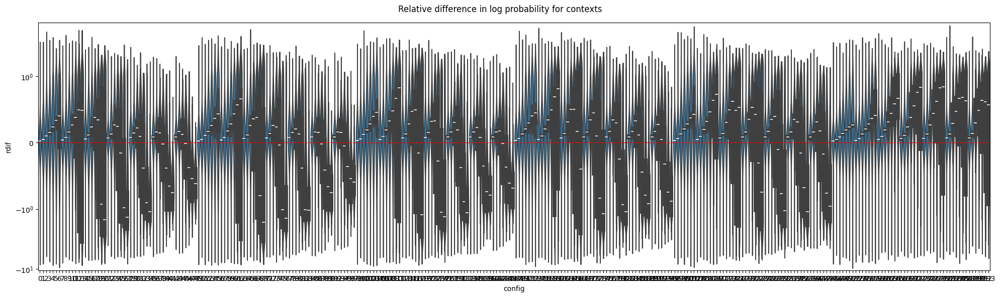

In [ ]:
# VIOLINPLOTS (not readable anymore)
fig, axs = plt.subplots(1,1,figsize=(20, 6))
sns.violinplot(data=df_logpc_r, y='rdif', x='config', ax=axs, dodge='auto', cut=0, density_norm="width")
axs.set_yscale('symlog', linthresh=1)
axs.axhline(0, color='red', linestyle='--', linewidth=1)
fig.suptitle('Relative difference in log probability for contexts')
plt.tight_layout()

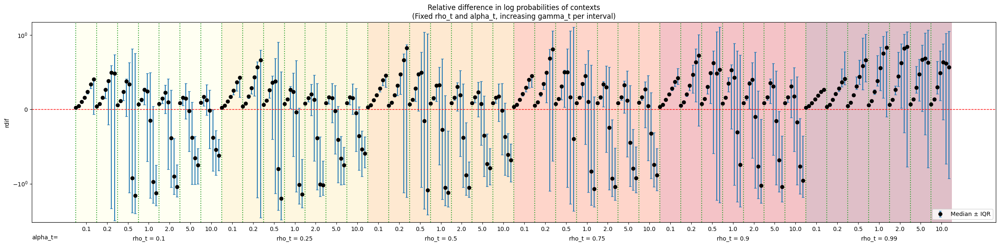

In [225]:
plot_rdif(df_logpc_r,'rho_t', 'alpha_t', 'gamma_t', which='contexts')

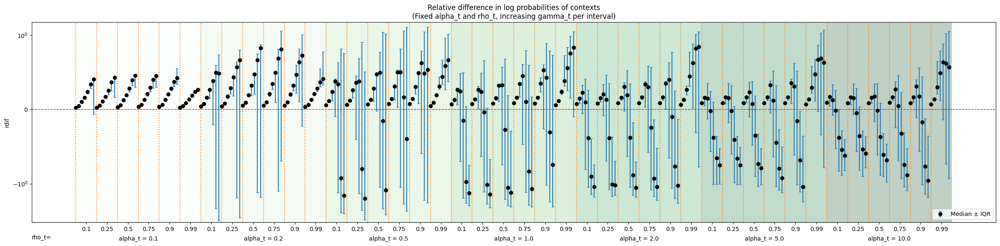

In [226]:
plot_rdif(df_logpc_r,'alpha_t','rho_t', 'gamma_t', which='contexts')

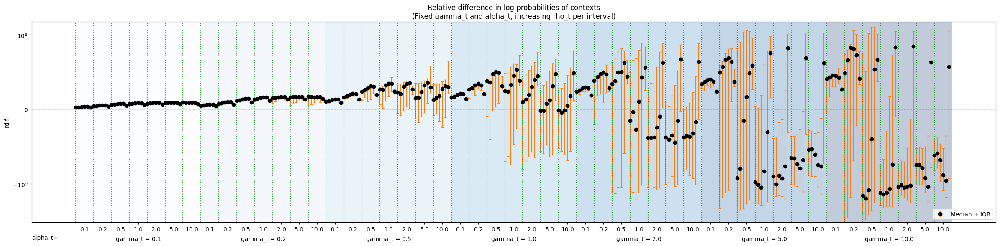

In [227]:
plot_rdif(df_logpc_r, 'gamma_t','alpha_t','rho_t', which='contexts')

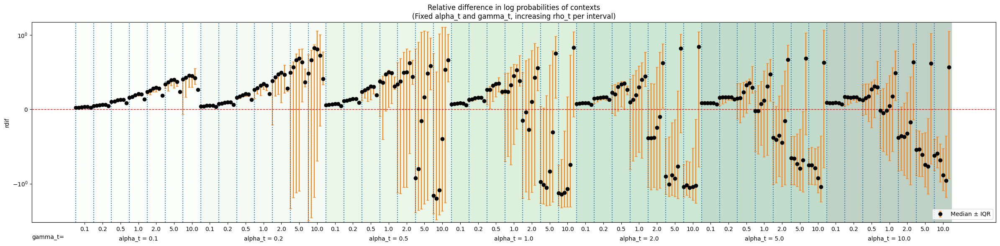

In [228]:
plot_rdif(df_logpc_r, 'alpha_t','gamma_t','rho_t', which='contexts')

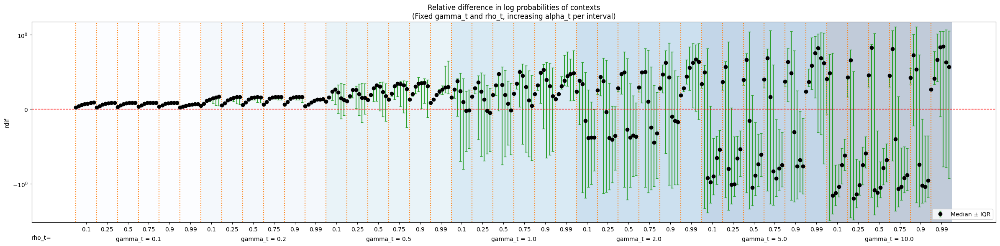

In [229]:
plot_rdif(df_logpc_r, 'gamma_t','rho_t', 'alpha_t', which='contexts')

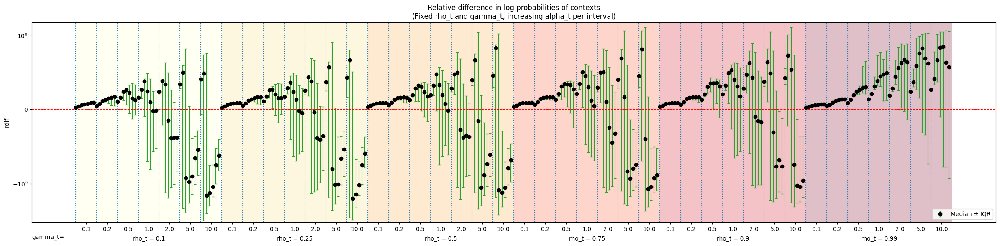

In [230]:
plot_rdif(df_logpc_r, 'rho_t', 'gamma_t', 'alpha_t', which='contexts')

### Parameter heatmaps

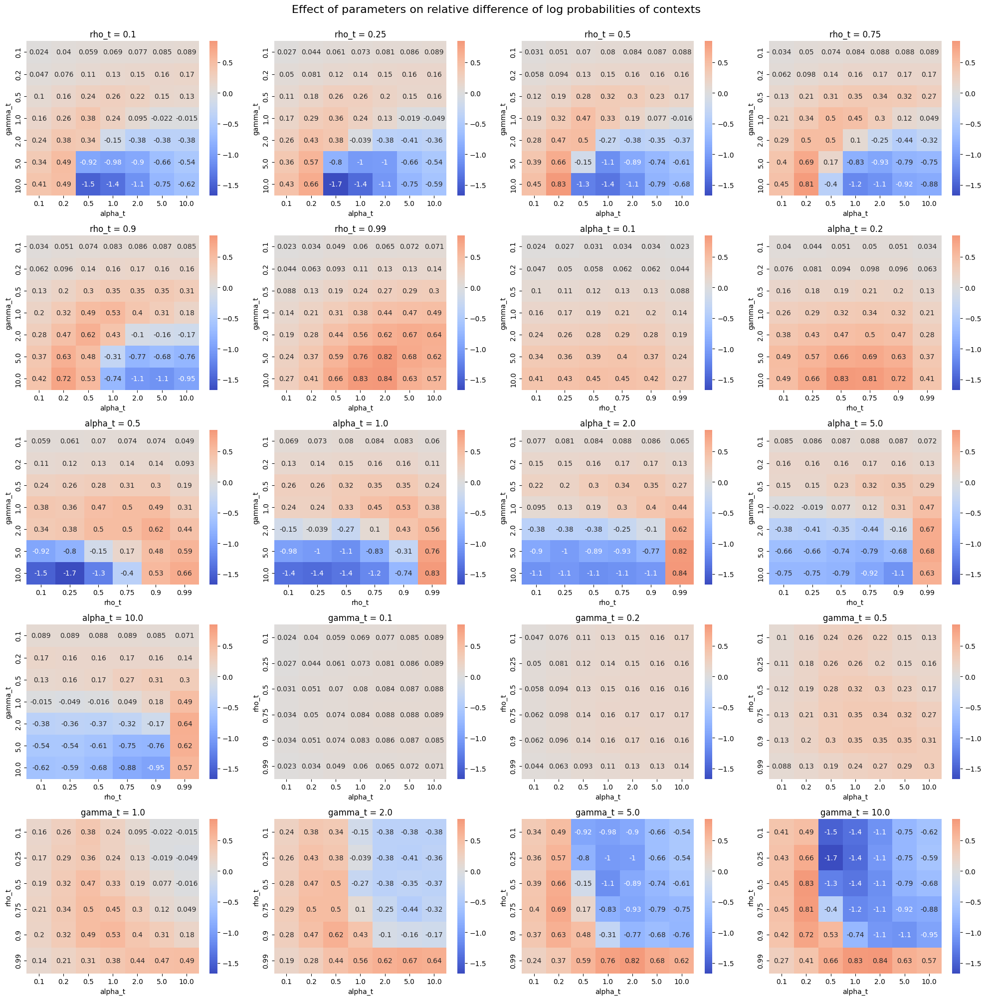

In [240]:
# Compute global vmin/vmax for consistent coloring across plots
vmin = df_logpc_r.groupby(['alpha_t', 'gamma_t', 'rho_t'])['rdif'].median().min()
vmax = df_logpc_r.groupby(['alpha_t', 'gamma_t', 'rho_t'])['rdif'].median().max()

# Define which parameters to fix and which to plot
combinations = [
    ('rho_t', 'alpha_t', 'gamma_t', df_logpc_r['rho_t'].unique()),
    ('alpha_t', 'rho_t', 'gamma_t', df_logpc_r['alpha_t'].unique()),
    ('gamma_t', 'alpha_t', 'rho_t', df_logpc_r['gamma_t'].unique())
]

# Count total number of plots needed
total_plots = sum(len(values) for _, _, _, values in combinations)

# Layout 
ncols = 4
nrows = int(np.ceil(total_plots / ncols))
fig, axs = plt.subplots(nrows, ncols, figsize=(5 * ncols, 4 * nrows))
axs = axs.flatten()

plot_idx = 0

for fixed_param, x_param, y_param, fixed_values in combinations:
    for val in sorted(fixed_values):  # sort for consistent order
        subset = df_logpc_r[df_logpc_r[fixed_param] == val]
        pivot = subset.pivot_table(
            index=y_param,
            columns=x_param,
            values='rdif',
            aggfunc='median'
        ).sort_index().sort_index(axis=1)

        sns.heatmap(pivot, annot=True, cmap='coolwarm', ax=axs[plot_idx],
                    vmin=vmin, vmax=vmax, center=0)

        axs[plot_idx].set_title(f"{fixed_param} = {val}")
        axs[plot_idx].set_xlabel(x_param)
        axs[plot_idx].set_ylabel(y_param)

        plot_idx += 1

# Hide any unused axes
for ax in axs[plot_idx:]:
    ax.set_visible(False)

fig.suptitle("Effect of parameters on relative difference of log probabilities of contexts", fontsize=16,y=1.0005)


plt.tight_layout()
plt.show()

### ---------- DRAFT -----------

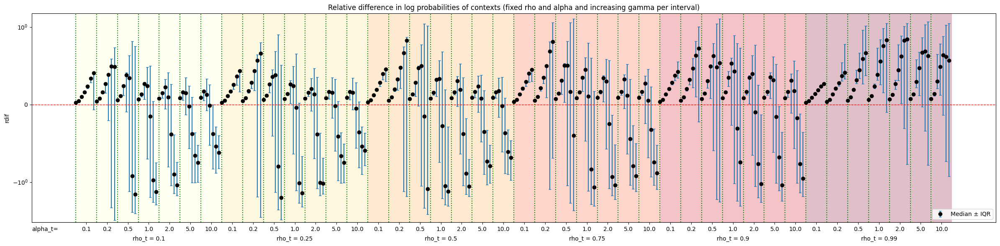

In [ ]:
# original order of dependency is: rho (6 values - color code YlOrRd)(+), alpha (7 values - color code Blues) (++), gamma (7 values - color code Greens) (+++)

summary = df_logpc_r.groupby('config')['rdif'].agg(
    rdif_5 = lambda x: np.percentile(x, 5),
    rdif_25 = lambda x: np.percentile(x, 25),
    rdif_50 = 'median',
    rdif_75 = lambda x: np.percentile(x, 75),
    rdif_95 = lambda x: np.percentile(x, 95)
)

summary['lower_err'] = summary['rdif_50'] - summary['rdif_25']
summary['upper_err'] = summary['rdif_75'] - summary['rdif_50']

plt.figure(figsize=(24, 6))
plt.errorbar(
    summary.index, summary['rdif_50'],
    yerr=[summary['lower_err'], summary['upper_err']],
    fmt='o', ecolor='tab:blue', capsize=2, color='black', label='Median ± IQR'
)
plt.axhline(0, color='red', linestyle='--', linewidth=1)

cmap = plt.colormaps['YlOrRd'].resampled(6) # MAKE SURE TO ADAPT HERE: 6 is for rho
colors = cmap(np.arange(0,cmap.N)) 
xticks = []
xticklabels = []
for i in range(int(294/(7*7))):   # MAKE SURE TO ADAPT HERE: 7 is for gamma, 7 is for alpha (we want to separate per rho)
    plt.axvspan(i*7*7,i*7*7 + 7*7,facecolor=colors[i], alpha=0.25) # HERE TOO
    xticks.append((2*i+1)*7*7/2) # HERE TOO
    xticklabels.append(f'rho_t = {df_logpc_r.rho_t.unique()[i]}') # MAKE SURE TO ADAPT LABEL HERE
plt.gca().set_xticks(xticks, labels=xticklabels)
plt.tick_params(axis="x", bottom=False, pad=20)

sec_xticks = []
sec_xtickslabels = []
for i in range(int(294/7)): # MAKE SURE TO ADAPT HERE: gamma (every six gamma)
    plt.axvline(i*7, color='green', linestyle='dotted')
    sec_xticks.append((2*i+1)*7/2) # HERE TOO
    sec_xtickslabels.append(f'{df_logpc_r.alpha_t.unique()[i%7]}') # MAKE SURE TO ADAPT HERE: 7 is for alpha // MAKE SURE TO ADAPT LABEL HERE
sec = plt.gca().secondary_xaxis(location=0)
sec.set_xticks(sec_xticks, labels=sec_xtickslabels)
sec.set_xlabel('alpha_t=', loc='left', labelpad=-9)

plt.yscale('symlog', linthresh=1)
plt.ylabel('rdif')
plt.title('Relative difference in log probabilities of contexts (fixed rho and alpha and increasing gamma per interval)')
plt.legend()
plt.tight_layout()

In [106]:
df_logpc_r.drop_duplicates(subset='config').head(20) 

,python,leaky,config,alpha_t,gamma_t,rho_t,n_ctx,rdif
0,-0.000143,-0.024125,0,0.1,0.1,0.1,4,0.023982
512,-0.000298,-0.047177,1,0.1,0.2,0.1,3,0.046879
1024,-0.000461,-0.100902,2,0.1,0.5,0.1,5,0.100441
1536,-0.000525,-0.158259,3,0.1,1.0,0.1,6,0.157734
2048,-0.000801,-0.237090,4,0.1,2.0,0.1,7,0.236290
2560,-0.002867,-0.339002,5,0.1,5.0,0.1,11,0.336134
3072,-0.001357,-0.407771,6,0.1,10.0,0.1,17,0.406414
3584,-0.000588,-0.039857,7,0.2,0.1,0.1,3,0.039269
4096,-0.000333,-0.076175,8,0.2,0.2,0.1,4,0.075843
4608,-0.663958,-0.924264,9,0.2,0.5,0.1,5,0.260306


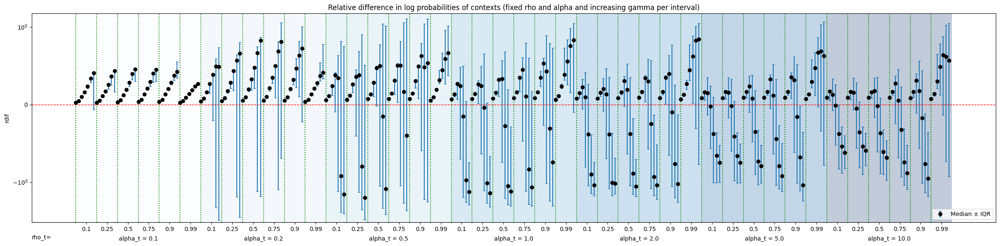

In [ ]:
df_logpc_r_reordered = df_logpc_r.sort_values(['alpha_t','rho_t','gamma_t',]).reset_index() # MODIFY THE ORDER OF LEVELS HERE
df_logpc_r_reordered['config']=df_logpc_r['config']

# original order is: rho (6 - YlOrRd)(+), alpha(7 - Blues) (++), gamma (7 - Greens) (+++)

summary = df_logpc_r_reordered.groupby('config')['rdif'].agg(
    rdif_5 = lambda x: np.percentile(x, 5),
    rdif_25 = lambda x: np.percentile(x, 25),
    rdif_50 = 'median',
    rdif_75 = lambda x: np.percentile(x, 75),
    rdif_95 = lambda x: np.percentile(x, 95)
)

summary['lower_err'] = summary['rdif_50'] - summary['rdif_25']
summary['upper_err'] = summary['rdif_75'] - summary['rdif_50']

plt.figure(figsize=(24, 6))
plt.errorbar(
    summary.index, summary['rdif_50'],
    yerr=[summary['lower_err'], summary['upper_err']],
    fmt='o', ecolor='tab:blue', capsize=2, color='black', label='Median ± IQR'
)
plt.axhline(0, color='red', linestyle='--', linewidth=1)

cmap = plt.colormaps['Blues'].resampled(7) # MAKE SURE TO ADAPT HERE: 7 is for alpha
colors = cmap(np.arange(0,cmap.N)) 
xticks = []
xticklabels = []
for i in range(int(294/(7*6))):     # MAKE SURE TO ADAPT HERE: 7 is for gamma, 6 is for rho
    plt.axvspan(i*7*6,i*7*6 + 7*6,facecolor=colors[i], alpha=0.25) # HERE TOO
    xticks.append((2*i+1)*7*6/2) # HERE TOO
    xticklabels.append(f'alpha_t = {df_logpc_r.alpha_t.unique()[i]}') # MAKE SURE TO ADAPT LABEL HERE
plt.gca().set_xticks(xticks, labels=xticklabels)
plt.tick_params(axis="x", bottom=False, pad=20)

sec_xticks = []
sec_xtickslabels = []
for i in range(int(294/7)):   # MAKE SURE TO ADAPT HERE: 7 is for gamma (every six gamma)
    plt.axvline(i*7, color='green', linestyle='dotted')
    sec_xticks.append((2*i+1)*7/2) # HERE TOO
    sec_xtickslabels.append(f'{df_logpc_r.rho_t.unique()[i%6]}')  # MAKE SURE TO ADAPT HERE: 6 is for rho // MAKE SURE TO ADAPT LABEL HERE
sec = plt.gca().secondary_xaxis(location=0)
sec.set_xticks(sec_xticks, labels=sec_xtickslabels)
sec.set_xlabel('rho_t=', loc='left')

plt.yscale('symlog', linthresh=1)
plt.ylabel('rdif')
plt.title('Relative difference in log probabilities of contexts (fixed alpha and rho and increasing gamma per interval)')
plt.legend()
plt.tight_layout()

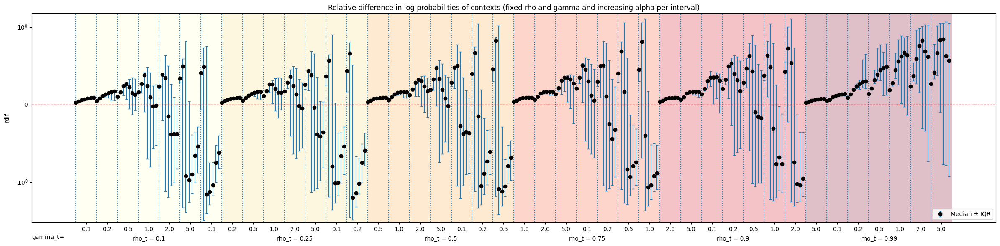

In [187]:
df_logpc_r_reordered = df_logpc_r.sort_values(['rho_t','gamma_t','alpha_t']).reset_index()
df_logpc_r_reordered['config']=df_logpc_r['config']

# original order is: rho (6 - YlOrRd)(+), alpha(7 - Blues) (++), gamma (7 - Greens) (+++)

summary = df_logpc_r_reordered.groupby('config')['rdif'].agg(
    rdif_5 = lambda x: np.percentile(x, 5),
    rdif_25 = lambda x: np.percentile(x, 25),
    rdif_50 = 'median',
    rdif_75 = lambda x: np.percentile(x, 75),
    rdif_95 = lambda x: np.percentile(x, 95)
)

summary['lower_err'] = summary['rdif_50'] - summary['rdif_25']
summary['upper_err'] = summary['rdif_75'] - summary['rdif_50']

plt.figure(figsize=(24, 6))
plt.errorbar(
    summary.index, summary['rdif_50'],
    yerr=[summary['lower_err'], summary['upper_err']],
    fmt='o', ecolor='tab:blue', capsize=2, color='black', label='Median ± IQR'
)
plt.axhline(0, color='red', linestyle='--', linewidth=1)

cmap = plt.colormaps['YlOrRd'].resampled(6)
colors = cmap(np.arange(0,cmap.N)) 
xticks = []
xticklabels = []
for i in range(int(294/(7*7))):
    plt.axvspan(i*7*7,i*7*7 + 7*7,facecolor=colors[i], alpha=0.25)
    xticks.append((2*i+1)*7*7/2)
    xticklabels.append(f'rho_t = {df_logpc_r.rho_t.unique()[i]}')
plt.gca().set_xticks(xticks, labels=xticklabels)
plt.tick_params(axis="x", bottom=False, pad=20)

sec_xticks = []
sec_xtickslabels = []
for i in range(int(294/7)):
    plt.axvline(i*7, color='tab:blue', linestyle='dotted')
    sec_xticks.append((2*i+1)*7/2)
    sec_xtickslabels.append(f'{df_logpc_r.gamma_t.unique()[i%6]}')
sec = plt.gca().secondary_xaxis(location=0)
sec.set_xticks(sec_xticks, labels=sec_xtickslabels)
sec.set_xlabel('gamma_t=', loc='left')

plt.yscale('symlog', linthresh=1)
plt.ylabel('rdif')
plt.title('Relative difference in log probabilities of contexts (fixed rho and gamma and increasing alpha per interval)')
plt.legend()
plt.tight_layout()